<a href="https://colab.research.google.com/github/Deok97/MultiLabel-Classification/blob/main/ResNet_Multi_label_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# [Usage examples with ResNet50 for Multi-label Image Classification](https://keras.io/api/applications/#usage-examples-for-image-classification-models)  

In [1]:
%matplotlib inline

In [2]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from google.colab import drive
import imageio
import glob
import cv2 as cv
import imutils
import math

import tensorflow.keras.applications as app
from tensorflow.keras.preprocessing import image

### Connection with Google Drive to use sample video data  

In [3]:
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
np.set_printoptions(precision=0.5, suppress=True)

## https://keras.io/api/applications/#usage-examples-for-image-classification-models  
## tf.kears.applications.{module}.{model} 사용시 3가지 수정  
1. tf.kears.applications.{module}.{model}  
2. tf.kears.applications.{module}.preprocess_input
3. tf.kears.applications.{module}.decode_predictions

In [120]:
class Classifier():
    def __init__(self, videoPath,
                 perFrame=24,
                 conf_thr = 0.5, # confidence score threshold
                 shape = (224, 224), # resize shape
                 module = app.resnet_v2, # using module according to model
                 model = app.resnet_v2.ResNet50V2(include_top=True, weights='imagenet', input_tensor=None,
                            input_shape=None, pooling=None, classes=1000,
                            classifier_activation='softmax')):
        self.videoPath = videoPath
        self.perFrame = perFrame
        self.conf_thr = conf_thr
        self.shape = shape
        self.module = module
        self.model = model
    
    def __model__(self):
        return self.model.summary()
    
    def video_classification(self):
        cap = cv.VideoCapture(self.videoPath)
        i=0
        res_count = dict()

        if not cap.isOpened():
            print('cannot open video')
            exit()

        while True:
            ret, frame_ = cap.read()
            if not ret:
                print("Can't receive frame (stream end?). Exiting ...\n")
                break
            if i % self.perFrame == 0:
                frame = cv.resize(frame_, self.shape)
                frame = np.expand_dims(frame, axis=0) # 차원 추가 (224, 224, 3) -> (1, 224, 224, 3)
                frame = self.module.preprocess_input(frame) # 2nd edit
                preds = self.model.predict(frame)
                result_ = np.array(self.module.decode_predictions(preds, top=3)[0]) # 3rd edit
                result = result_[:, 1:]

                # 특정 키워드가 신뢰도 0.5를 넘었을 때, top-3 안에 몇번 나왔는가?
                key_list = result[result[:, 1].astype(float) > self.conf_thr, 0]
                for key in key_list:
                    res_count[key] = res_count.get(key, 0) + 1

                plt.imshow(frame_)
                plt.title(f'Predicted class: {result[0, 0]}, Score: {result[0, 1]}')
                plt.show()
            i +=1
        sorted_dict = sorted(res_count.items(), key = (lambda item: item[1]), reverse=True)
        print(sorted_dict)
        return sorted_dict



In [119]:
clsf = Classifier(videoPath='/content/gdrive/MyDrive/sample/pistol_sample.mp4')
clsf.__dict__

{'conf_thr': 0.5,
 'model': <keras.engine.functional.Functional at 0x7fae04090b90>,
 'module': <module 'keras.api._v2.keras.applications.resnet_v2' from '/usr/local/lib/python3.7/dist-packages/keras/api/_v2/keras/applications/resnet_v2/__init__.py'>,
 'perFrame': 24,
 'shape': (224, 224),
 'videoPath': '/content/gdrive/MyDrive/sample/pistol_sample.mp4'}

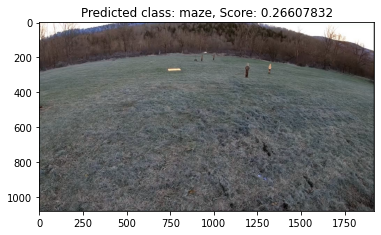

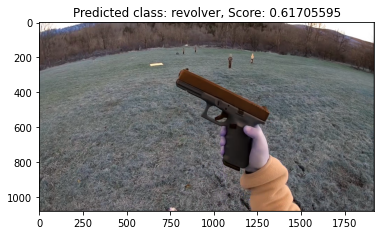

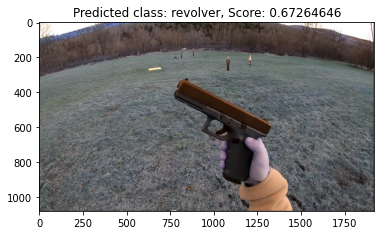

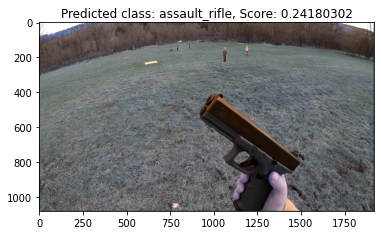

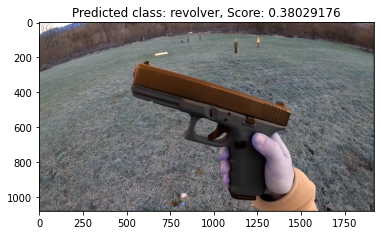

...

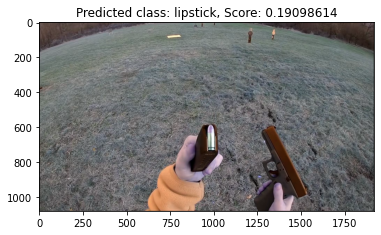

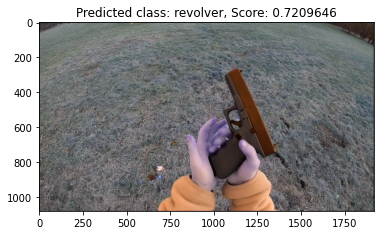

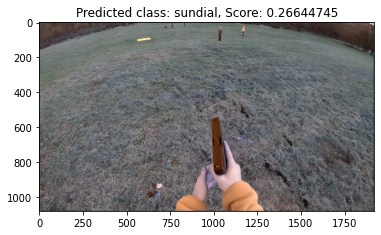

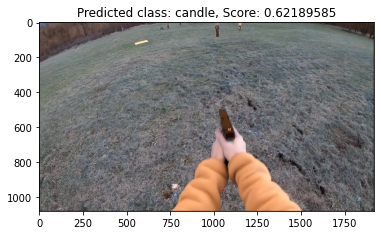

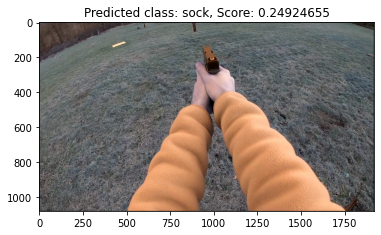

In [ ]:
clsf = Classifier(videoPath='/content/gdrive/MyDrive/sample/pistol_sample.mp4', perFrame=50)
clsf.video_classification()

## Fine tuning; 사전학습 모델로 재학습이 필요한가?  


## Visualization of video predictions  
#### 동영상에 대해 period 마다 frame을 추출하여 분류 진행  
[ImageNet [클래스 ID, 클래스 이름, score] 리스트](https://gist.github.com/aaronpolhamus/964a4411c0906315deb9f4a3723aac57)

In [110]:
def vid_clsf(videoPath, period):
    cap = cv.VideoCapture(videoPath)
    i=0
    period = period
    
    res_count = dict()

    if not cap.isOpened():
        print('cannot open video')
        exit()

    while True:
        ret, frame_ = cap.read()
        if not ret:
            print("Can't receive frame (stream end?). Exiting ...\n")
            break
        if i%period == 0:
            frame = cv.resize(frame_, (224, 224))
            frame = np.expand_dims(frame, axis=0) # 차원 추가 (224, 224, 3) -> (1, 224, 224, 3)
            frame = app.resnet_v2.preprocess_input(frame) # 2nd edit
            preds = model.predict(frame)
            result_ = np.array(app.resnet_v2.decode_predictions(preds, top=3)[0]) # 3rd edit
            result = result_[:, 1:]

            # 특정 키워드가 신뢰도 0.5를 넘었을 때, top-3 안에 몇번 나왔는가?
            con_threshold = 0.5
            key_list = result[result[:, 1].astype(float) > con_threshold, 0]
            for key in key_list:
                res_count[key] = res_count.get(key, 0) + 1

            plt.imshow(frame_)
            plt.title(f'Predicted class: {result[0, 0]}, Score: {result[0, 1]}')
            plt.show()

        i +=1
    print(res_count)
    return res_count



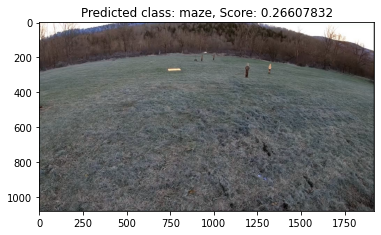

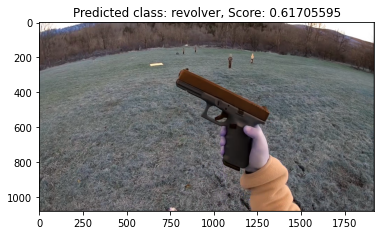

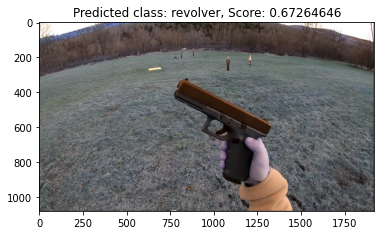

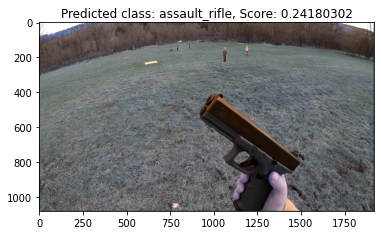

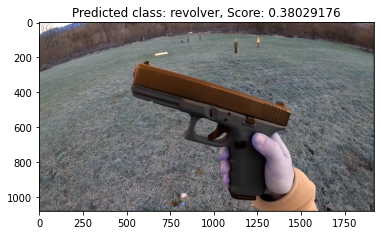

...

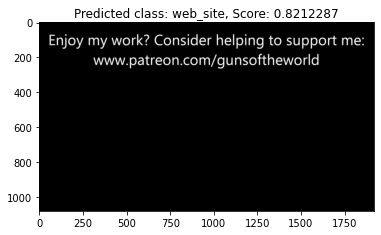

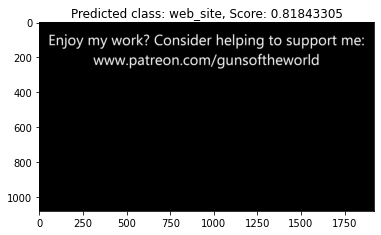

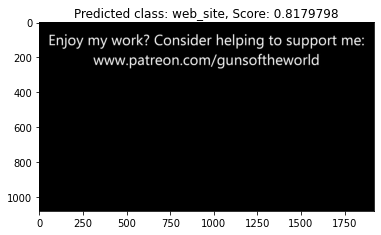

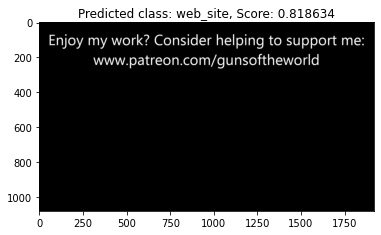

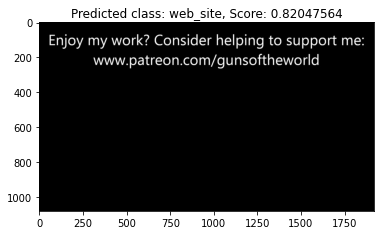

Can't receive frame (stream end?). Exiting ...
{'revolver': 17, 'rifle': 12, 'candle': 3, 'slug': 1, 'king_penguin': 6, 'lighter': 1, 'sock': 2, 'spindle': 1, 'ski_mask': 2, 'mailbox': 1, 'swimming_trunks': 2, 'nipple': 4, 'lipstick': 1, 'missile': 1, 'web_site': 5}


In [111]:
videoPath = '/content/gdrive/MyDrive/sample/pistol_sample.mp4'
period = 50
vid_clsf(videoPath, period)

--- 
# 데이터 형식
- model input: (N, 231, 231, 3)  
- model output: (N, 1, 1, C) ex. [[[[0.8823, 0.2134]]], [[[0.1234, 0.5678]]], ..., [[[0.0024, 0.1231]]]]  
- N은 이미지의 개수를 의미  
- C는 클래스의 개수(현재는 총, 칼이므로 2임)를 의미
  - ex. model의 입력으로 3장의 이미지가 들어갔다면
  - model input: (3, 231, 231, 3)
  - model output: (3, 1, 1, 2)




---------------------- 

# 작성자 Notes To Do  


In [ ]:
"""
# To Do
- 왜 softmax -> sigmoid로 변경해도 모델의 출력 값의 합이 1에 가까운가?  
- 어째서 배경을 보고 knife라고 분류하는가?  

# Options
- 다른 모델을 사용해야하는가?: [class-specific residual attention (CSRA)](https://arxiv.org/pdf/2108.02456v2.pdf)  
  - 참고 사이트: [multilabel classification state of art 모델](https://paperswithcode.com/search?q_meta=&q_type=&q=multi+label+classification)  
  - 참고 사이트2; [skmultilearn 라이브러리로 구현가능](https://github.com/scikit-multilearn/scikit-multilearn)   
  - 참고 사이트3; [CSRA 구현코드](https://github.com/Kevinz-code/CSRA) 
- 모델을 직접 구축하고 가중치를 매번 구하는 것보다 이미 나와있는 모델과 pretrained 된 가중치를 사용하는 것이 더 좋아보인다  
"""